In [1]:
# This entire block helps with relative imports
import glob
import os, sys
dir2 = os.path.abspath('')
dir1 = os.path.dirname(dir2)
if not dir1 in sys.path: sys.path.append(dir1)
from tempest_extremes.utils import read_tempest_csv, read_tempest_ASCII
from utils.processing import saffir_simpson

from haversine import inverse_haversine, haversine_vector, haversine

import pandas as pd
import numpy as np
import xarray as xr
import netCDF4 as nf4
import matplotlib.pyplot as plt
import seaborn as sns

import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [2]:
# block to calculate distance from miami
def miami_storms(df, distance=500.0, units='km'):

    miami_coords = (25.775163, -80.208615)
    miami_dist = distance #km
    df['miami_dist'] = df.apply(lambda x: haversine_vector((x.lat, x.lon), 
                                                                     miami_coords, unit=units, 
                                                                     normalize=True)[0], axis=1).round(2)
    df = df[df['miami_dist'].apply(lambda x: x <= miami_dist)].reset_index(drop=True)
    storms = df['tempest_ID'].unique()
    
    return storms

# method 1: filter down to tempest_IDs and select by tempest_IDs
# method 2: return full dataframe, only graph select few

In [3]:
def all_calcs(dataframe, distance=500, units='km'):
    # calculates distance from Miami
    miami_coords = (25.775163, -80.208615)
    miami_dist = distance #km
    df = dataframe.copy()
    df['miami_dist'] = df.apply(lambda x: haversine_vector((x.lat, x.lon), 
                                                                     miami_coords, unit=units, 
                                                                     normalize=True)[0], axis=1).round(2)
    
    # calculates Saffir-Simpson scale
    df['ss_wsp'] = df.apply(lambda x: saffir_simpson(x.wsp, 'm/s'), axis=1)
    
    return df

In [4]:
#tracks_folder = r"/Users/cnd5285/Library/CloudStorage/OneDrive-ThePennsylvaniaStateUniversity/DeCiampa/model_traj"
tracks_folder = '../tempest_extremes/model_traj'
te_track_files = glob.glob(os.path.join(tracks_folder, '*'))
te_track_files

['../tempest_extremes/model_traj/trajectories.txt.CHEY.VR28.NATL.REF.CAM5.4CLM5.0.dtime900.002',
 '../tempest_extremes/model_traj/trajectories.txt.CORI.VR28.NATL.EXT.CAM5.4CLM5.0.dtime900.003',
 '../tempest_extremes/model_traj/trajectories.txt.CHEY.VR28.NATL.REF.CAM5.4CLM5.0.dtime900',
 '../tempest_extremes/model_traj/trajectories.txt.CHEY.VR28.NATL.WAT.CAM5.4CLM5.0.dtime900',
 '../tempest_extremes/model_traj/trajectories.txt.CHEY.VR28.NATL.WAT.CAM5.4CLM5.0.dtime900.002',
 '../tempest_extremes/model_traj/trajectories.txt.CORI.VR28.NATL.REF.CAM5.4CLM5.0.dtime900.003',
 '../tempest_extremes/model_traj/trajectories.txt.CHEY.VR28.NATL.EXT.CAM5.4CLM5.0.dtime900.002',
 '../tempest_extremes/model_traj/trajectories.txt.CORI.VR28.NATL.WAT.CAM5.4CLM5.0.dtime900.003',
 '../tempest_extremes/model_traj/trajectories.txt.CHEY.VR28.NATL.EXT.CAM5.4CLM5.0.dtime900']

In [24]:
te_track_files[0].split('/')[-1]

'trajectories.txt.CHEY.VR28.NATL.REF.CAM5.4CLM5.0.dtime900.002'

In [5]:
colnames = ['timestep', 'lon', 'lat', 'slp', 'wsp', 'sfc_phi', 'year', 'month', 'day', 'hour']
te_track_dfs = [read_tempest_ASCII(f, colnames) for f in te_track_files]
te_tracks = [all_calcs(df) for df in te_track_dfs]

In [6]:
te_track_dfs[0]

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID
0,1985-01-25 00:00:00,83.116714,7.634498,98708.27,32.26449,0.000,storm_0
1,1985-01-25 06:00:00,82.070597,7.592107,99701.32,27.35374,0.000,storm_0
2,1985-01-25 12:00:00,82.070597,7.592107,99822.81,24.49513,0.000,storm_0
3,1985-01-25 18:00:00,80.359140,7.493154,100234.10,18.41094,1473.759,storm_0
4,1985-01-26 00:00:00,79.980944,6.945498,100137.90,16.64115,350.854,storm_0
...,...,...,...,...,...,...,...
38858,2014-12-06 00:00:00,119.008239,-22.209494,99071.34,15.27198,4827.211,storm_1530
38859,2014-12-06 06:00:00,119.814654,-23.600902,99427.77,14.23425,5750.282,storm_1530
38860,2014-12-06 12:00:00,121.385520,-24.424525,99674.34,11.88024,5445.413,storm_1530
38861,2014-12-06 18:00:00,123.473148,-25.477910,99659.17,12.88766,5186.333,storm_1530


In [7]:
te_tracks = [all_calcs(df) for df in te_track_dfs]

In [9]:
te_tracks[0]

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist,ss_wsp
0,1985-01-25 00:00:00,83.116714,7.634498,98708.27,32.26449,0.000,storm_0,15885.98,Tropical Storm
1,1985-01-25 06:00:00,82.070597,7.592107,99701.32,27.35374,0.000,storm_0,15839.60,Tropical Storm
2,1985-01-25 12:00:00,82.070597,7.592107,99822.81,24.49513,0.000,storm_0,15839.60,Tropical Storm
3,1985-01-25 18:00:00,80.359140,7.493154,100234.10,18.41094,1473.759,storm_0,15761.23,Tropical Storm
4,1985-01-26 00:00:00,79.980944,6.945498,100137.90,16.64115,350.854,storm_0,15793.88,Tropical Depression
...,...,...,...,...,...,...,...,...,...
38858,2014-12-06 00:00:00,119.008239,-22.209494,99071.34,15.27198,4827.211,storm_1530,18025.05,Tropical Depression
38859,2014-12-06 06:00:00,119.814654,-23.600902,99427.77,14.23425,5750.282,storm_1530,17979.74,Tropical Depression
38860,2014-12-06 12:00:00,121.385520,-24.424525,99674.34,11.88024,5445.413,storm_1530,17837.93,Tropical Depression
38861,2014-12-06 18:00:00,123.473148,-25.477910,99659.17,12.88766,5186.333,storm_1530,17643.83,Tropical Depression


In [152]:
te_tracks[0][te_tracks[0]['ss_wsp'] == 'Category 5']

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist,ss_wsp
758,1985-08-12 00:00:00,297.112202,16.216557,92756.82,70.76490,0.0,storm_27,2085.40,Category 5
759,1985-08-12 06:00:00,296.053639,16.856755,93722.52,73.78926,0.0,storm_27,1952.01,Category 5
760,1985-08-12 12:00:00,295.358511,17.555571,90218.67,72.63097,0.0,storm_27,1847.85,Category 5
761,1985-08-12 18:00:00,294.663186,18.641338,89965.30,83.42808,0.0,storm_27,1722.42,Category 5
762,1985-08-13 00:00:00,294.029087,19.617340,91174.99,98.03029,0.0,storm_27,1611.62,Category 5
...,...,...,...,...,...,...,...,...,...
38338,2014-09-03 06:00:00,310.975368,27.141301,91840.66,76.99336,0.0,storm_1511,3100.13,Category 5
38339,2014-09-03 12:00:00,311.589742,28.220149,90965.79,77.06995,0.0,storm_1511,3153.28,Category 5
38340,2014-09-03 18:00:00,312.683204,29.702862,91705.43,74.17575,0.0,storm_1511,3255.47,Category 5
38341,2014-09-04 00:00:00,314.266384,31.116035,92608.48,71.82707,0.0,storm_1511,3408.60,Category 5


In [ ]:
plot = sns.FacetGrid(te_tracks)

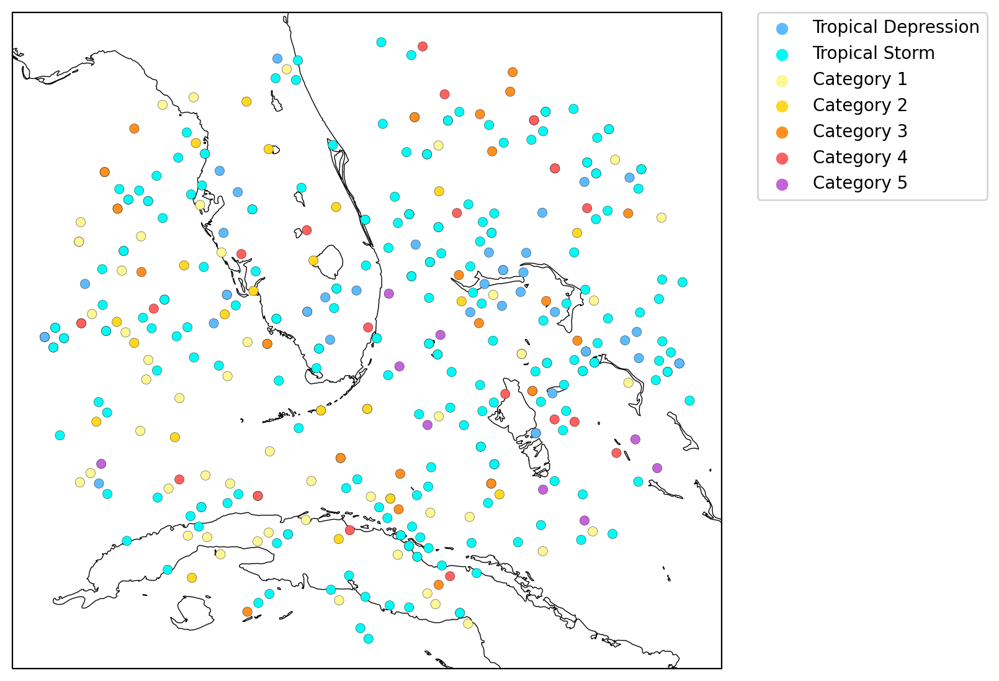

In [105]:
proj=ccrs.PlateCarree(globe=None)
fig, ax = plt.subplots(figsize=(12,7), dpi=200, subplot_kw=dict(projection=proj))
ax.add_feature(cfeature.COASTLINE.with_scale('10m'), linewidth=0.5, zorder=1)
ax.add_feature(cfeature.LAKES.with_scale('10m'), linewidth=0.5, facecolor='w', edgecolor='black', zorder=1)

g1 = sns.scatterplot(x='lon', y='lat', data=te_tracks[0][te_tracks[0]['miami_dist'] <= 500.0], edgecolor='black', linewidth=0.15, s=30,
                hue='ss_wsp', hue_order=color_order, palette=sns.color_palette(cat_colors), transform=proj, ax=ax)
h,l = g1.get_legend_handles_labels()
plt.legend(h[0:8],l[0:13],bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

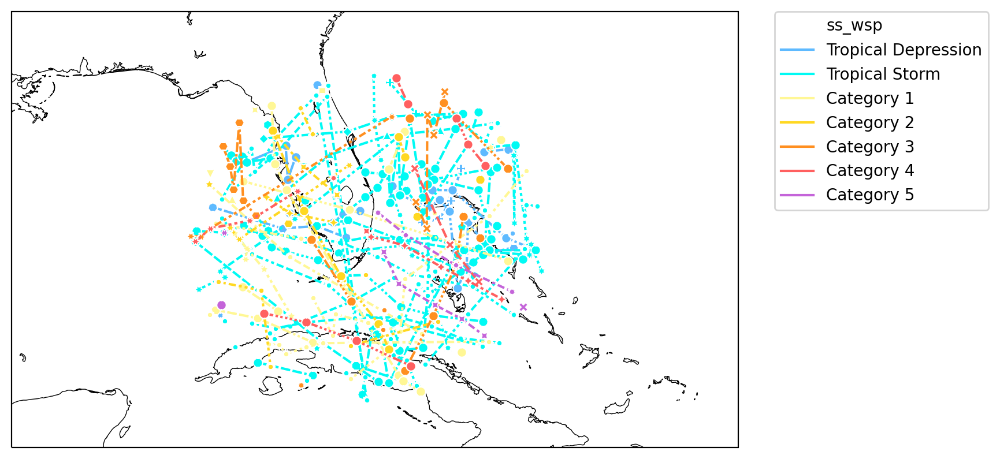

In [57]:
proj=ccrs.PlateCarree(globe=None)
fig, ax = plt.subplots(figsize=(10,5), dpi=200, subplot_kw=dict(projection=proj))

ax.set_extent([270., 290., 20., 32])
ax.add_feature(cfeature.COASTLINE.with_scale('10m'), linewidth=0.5, zorder=1)
ax.add_feature(cfeature.LAKES.with_scale('10m'), linewidth=0.5, facecolor='w', edgecolor='black', zorder=1)
#ax.add_feature(cfeature.STATES, linewidth=0.5)
#ax.add_feature(cfeature.BORDERS, linewidth=0.5)

color_order = ['Tropical Depression', 'Tropical Storm', 'Category 1', 'Category 2', 'Category 3', 'Category 4', 'Category 5']
cat_colors = ['#5EBAFF', '#00FAF4', '#FFF795', '#FFD821', '#FF8F20', '#FF6060', '#C464D9']

# sns.scatterplot(x='lon', y='lat', data=te_tracks[0][te_tracks[0]['miami_dist'] <= 500.0], 
#                 hue='ss_wsp', hue_order=color_order, palette=sns.color_palette(cat_colors), transform=proj, ax=ax)
g = sns.lineplot(x='lon', y='lat', data=te_tracks[0][te_tracks[0]['miami_dist'] <= 500.0], markers=True, style='tempest_ID',
                hue='ss_wsp', hue_order=color_order, palette=sns.color_palette(cat_colors), transform=proj, ax=ax, zorder=10)
h,l = g.get_legend_handles_labels()
plt.legend(h[0:8],l[0:13],bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show(g)
#plt.show()

In [ ]:
sns.set()

In [27]:
os.path.isdir('../figs/te_plots', te_track_files[0].split('/')[-1]))

True

In [28]:
os.path.join('../figs/te_plots', te_track_files[0].split('/')[-1]+'.png')

'../figs/te_plots/trajectories.txt.CHEY.VR28.NATL.REF.CAM5.4CLM5.0.dtime900.002.png'

In [53]:
def compare_te_tracks(df, file_name):
    proj=ccrs.PlateCarree(globe=None)
    color_order = ['Tropical Depression', 'Tropical Storm', 'Category 1', 'Category 2', 'Category 3', 'Category 4', 'Category 5']
    cat_colors = ['#5EBAFF', '#00FAF4', '#FFF795', '#FFD821', '#FF8F20', '#FF6060', '#C464D9']

    g = sns.FacetGrid(df[df['miami_dist'] <= 500.0], col="tempest_ID", hue='ss_wsp',
                      col_wrap=8, height=3.5, hue_order=color_order, palette=sns.color_palette(cat_colors),
                      subplot_kws=dict(projection=proj))
    #g3.map_dataframe(sns.lineplot, x='lon', y='lat')
    g.map_dataframe(sns.scatterplot, x='lon', y='lat', zorder=10, s=20, edgecolor='black', linewidth=0.5)

    title = file_name.split('/')[-1]
    g.fig.suptitle(title, fontsize=16, fontweight='bold')
    g.figure.subplots_adjust(top=.96)
    g.set_titles(size=12)

    for ax in g.axes.ravel():
        #ax.set_extent([270., 290., 20., 32])
        ax.add_feature(cfeature.COASTLINE.with_scale('10m'), linewidth=0.5, zorder=1)
        ax.add_feature(cfeature.LAKES.with_scale('10m'), linewidth=0.5, facecolor='w', edgecolor='black', zorder=1)
    
    plt.savefig(os.path.join('../figs/te_plots', title+'.png'), dpi=300)

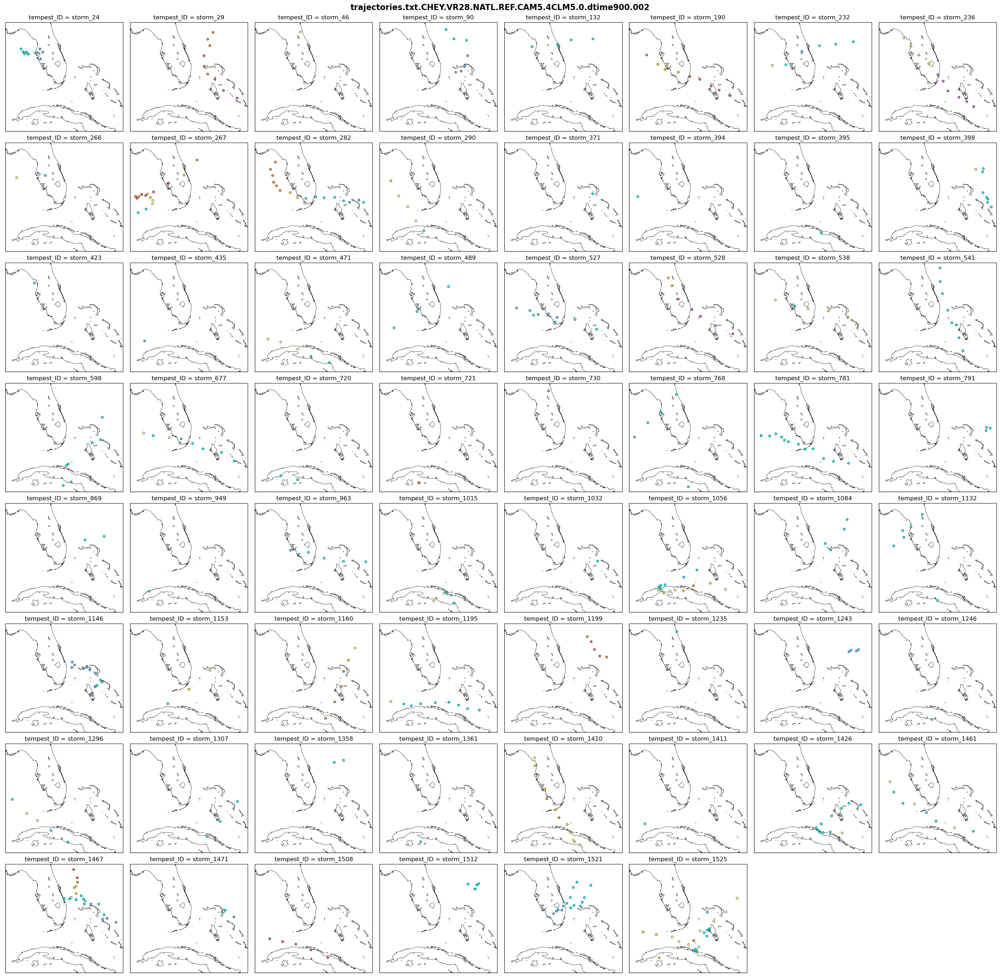

In [52]:
compare_te_tracks(te_tracks[0], te_track_files[0])

[None, None, None, None, None, None, None, None, None]

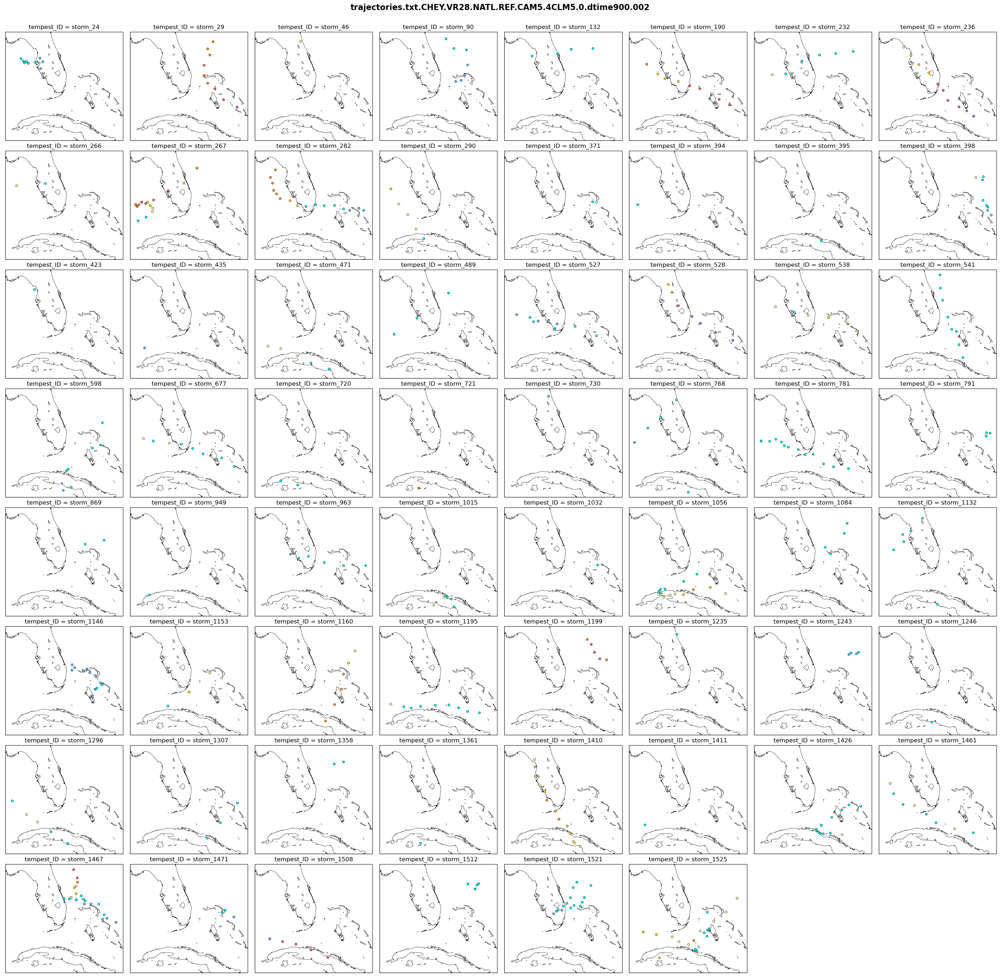

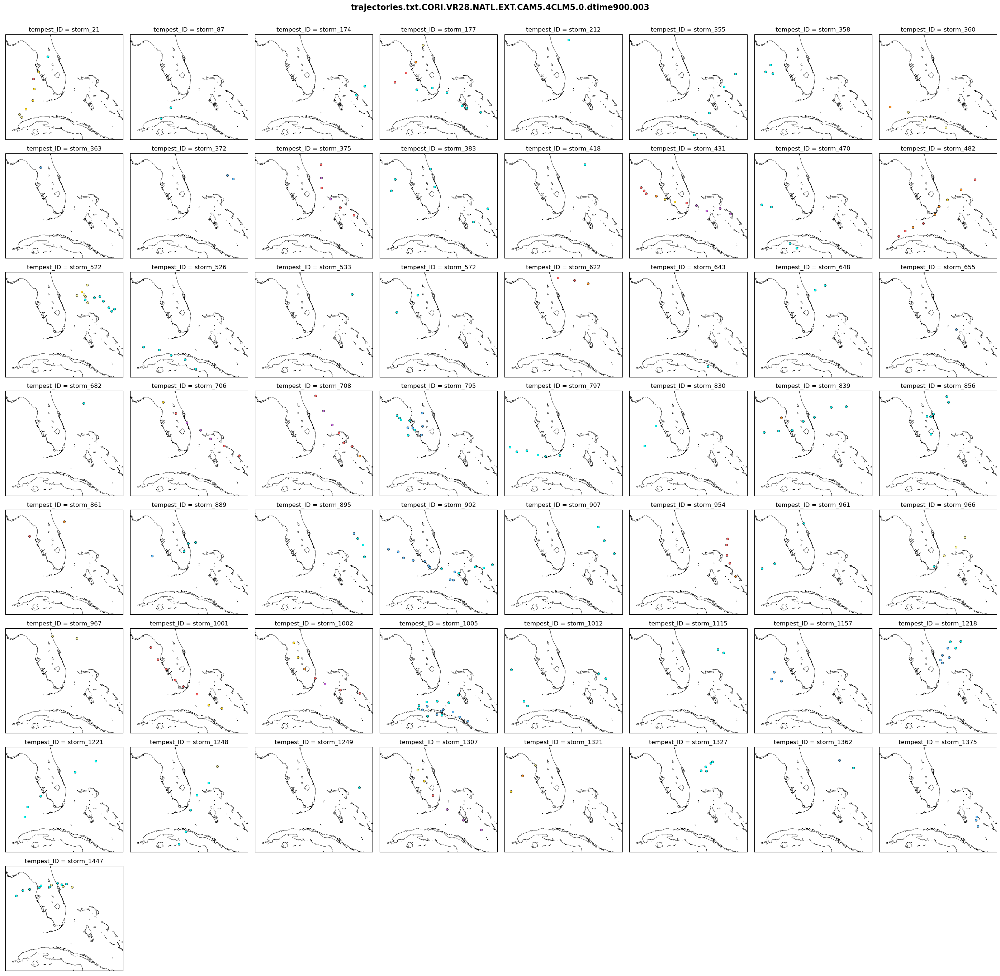

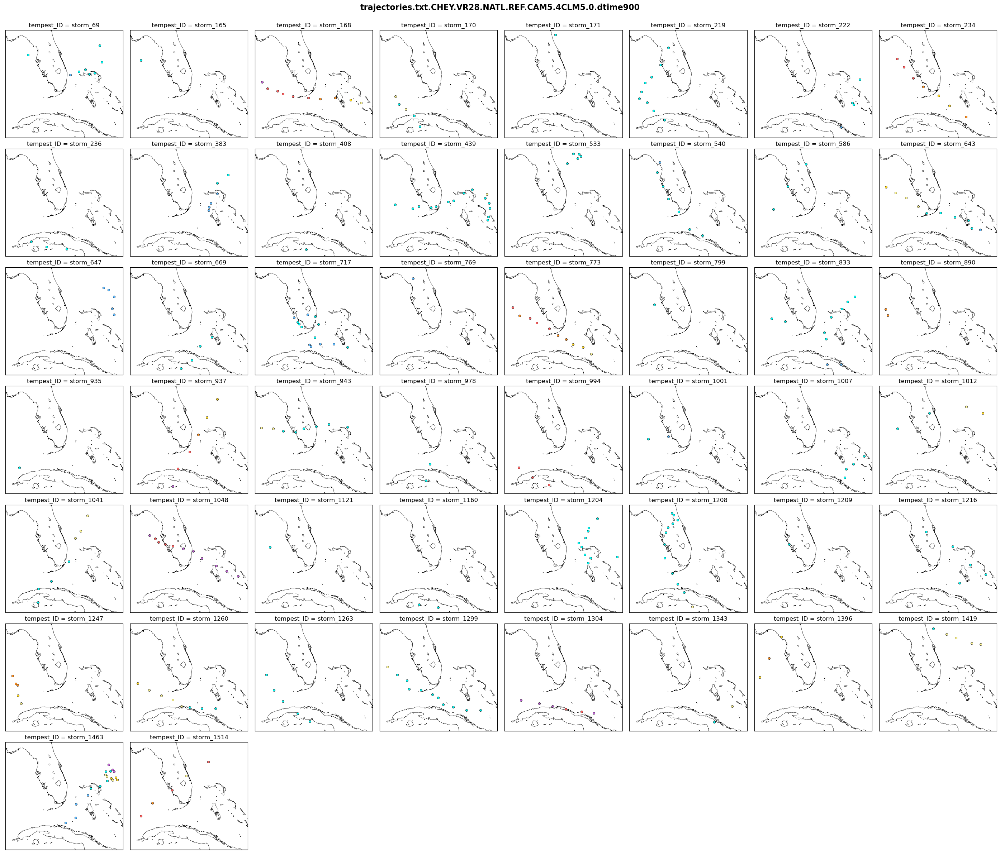

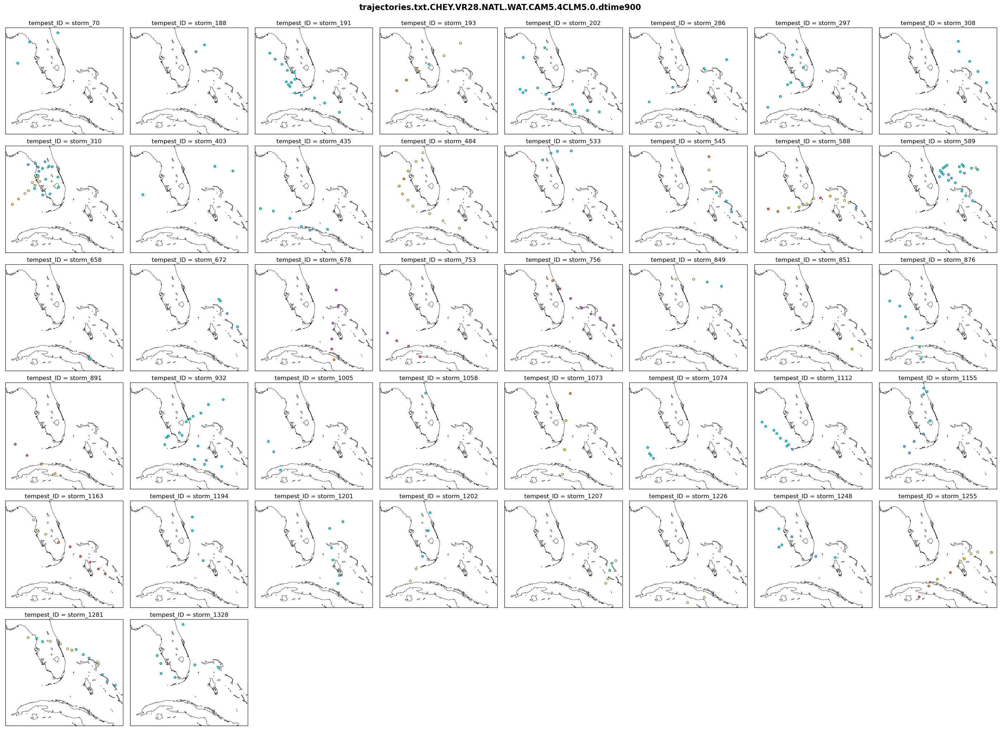

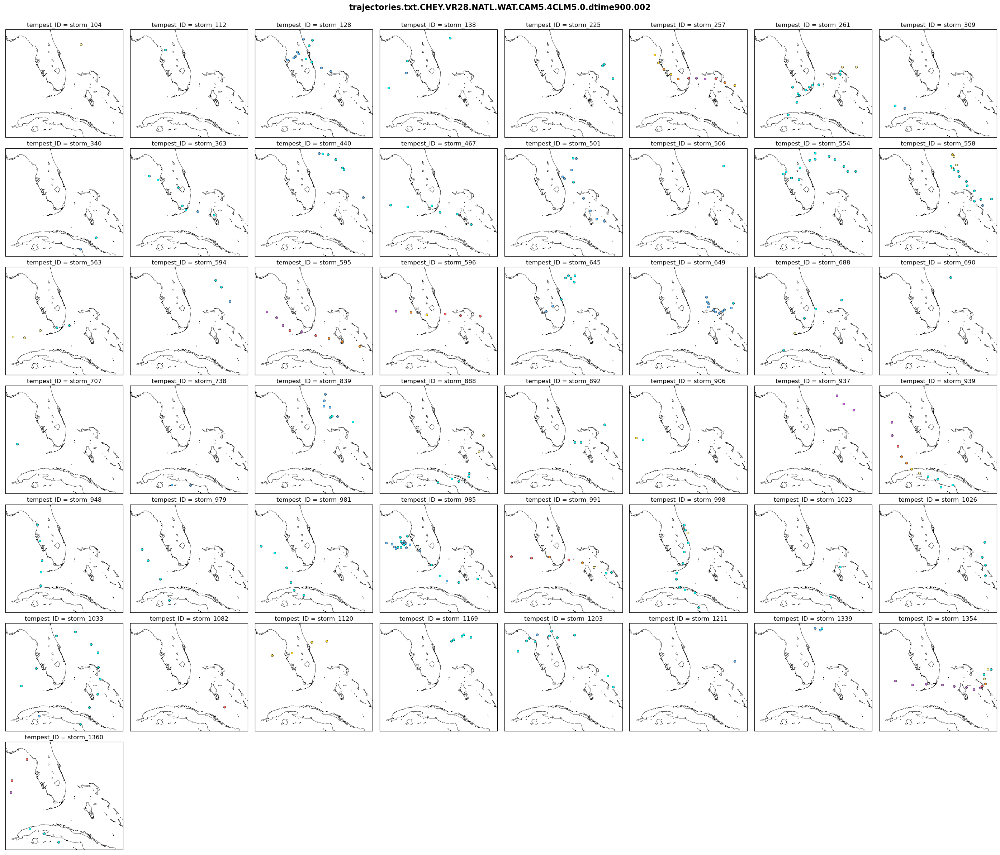

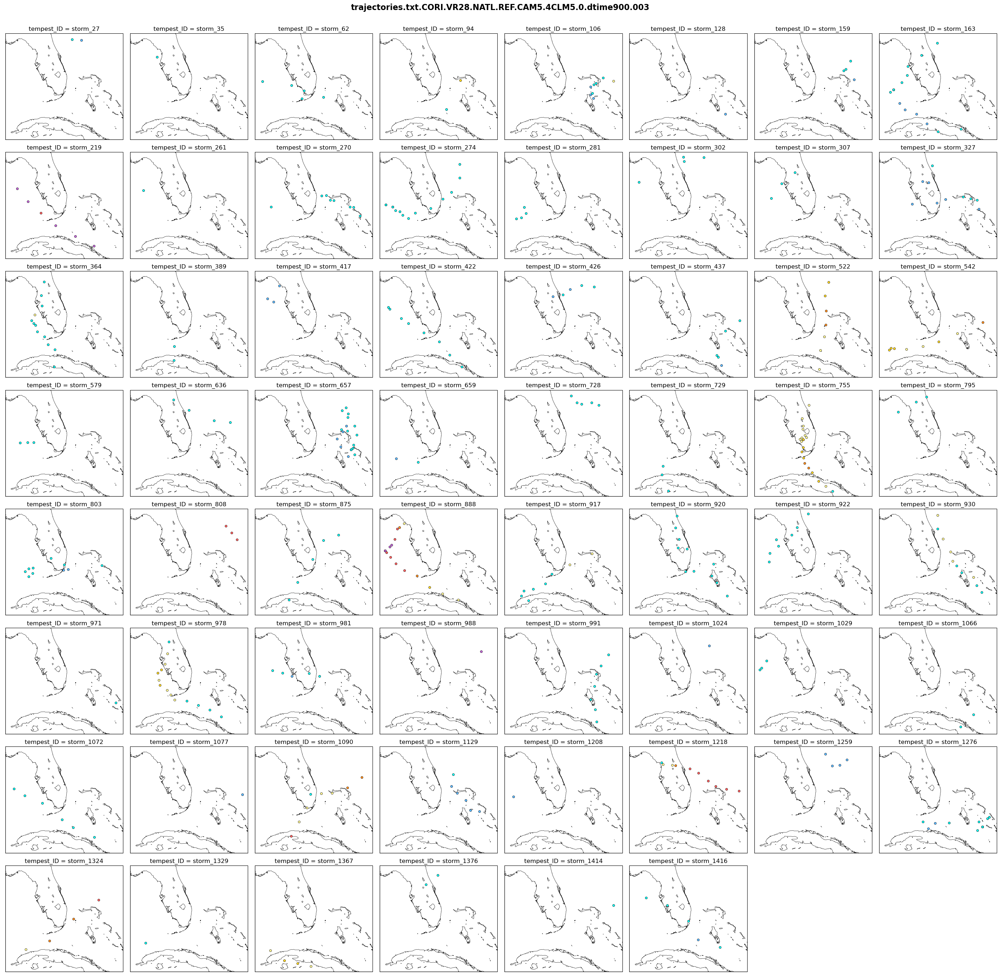

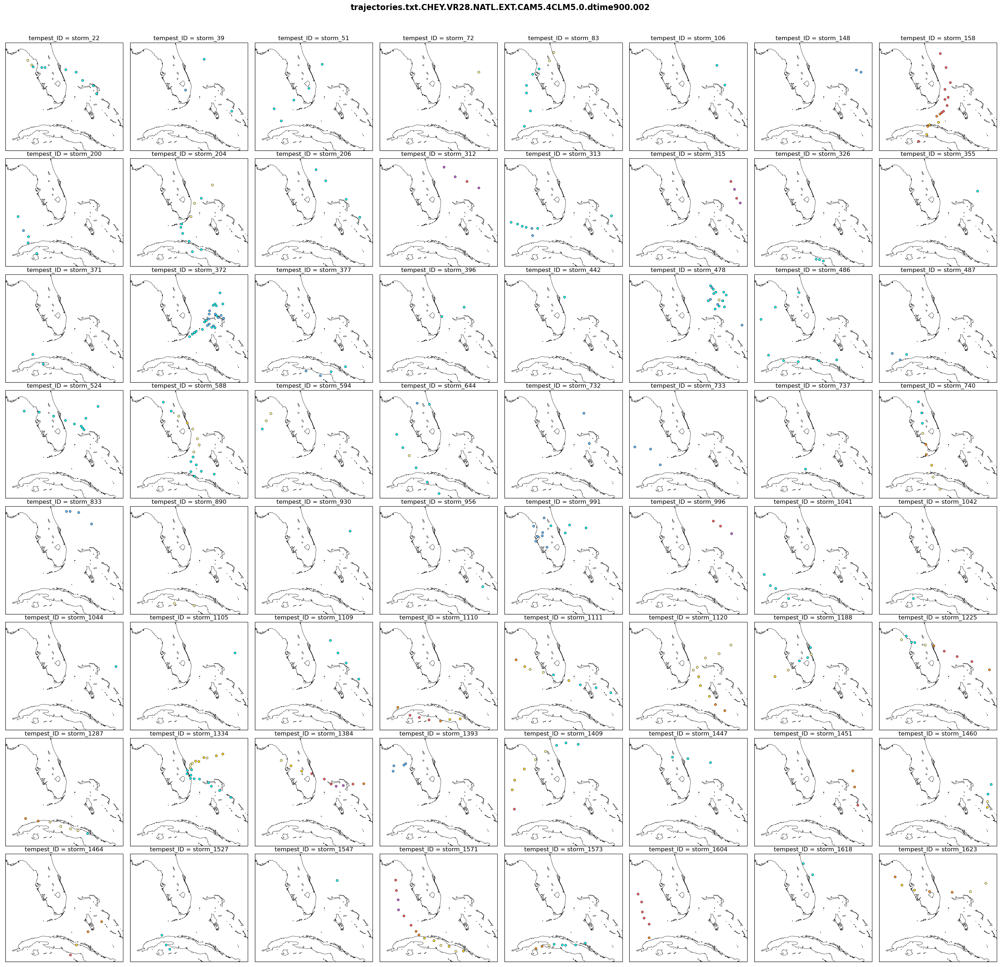

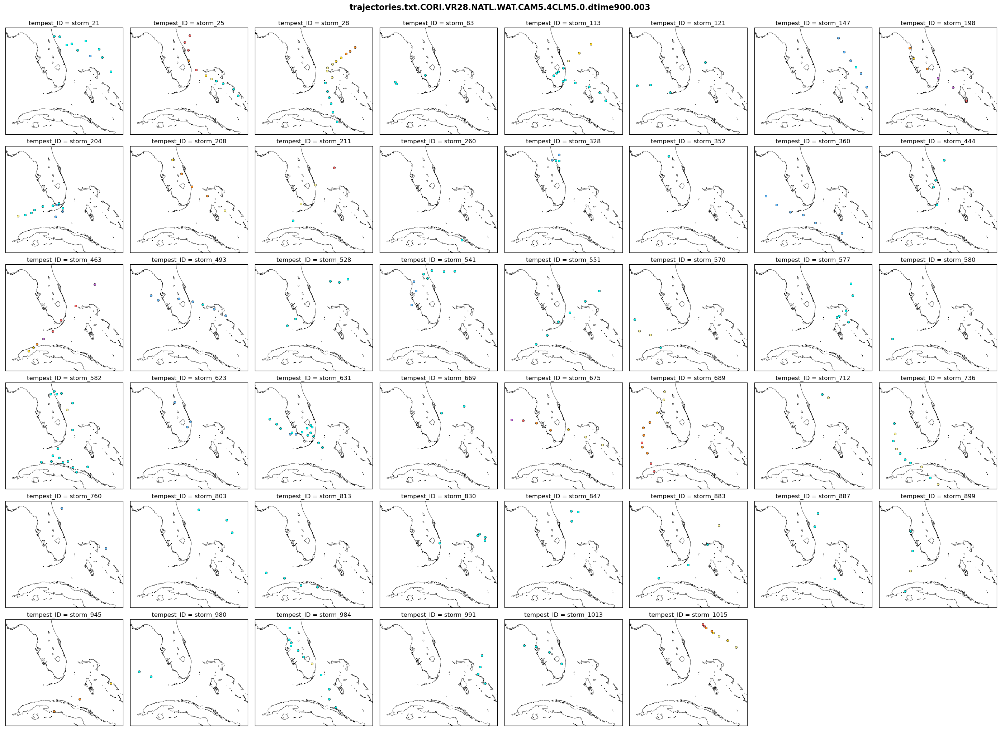

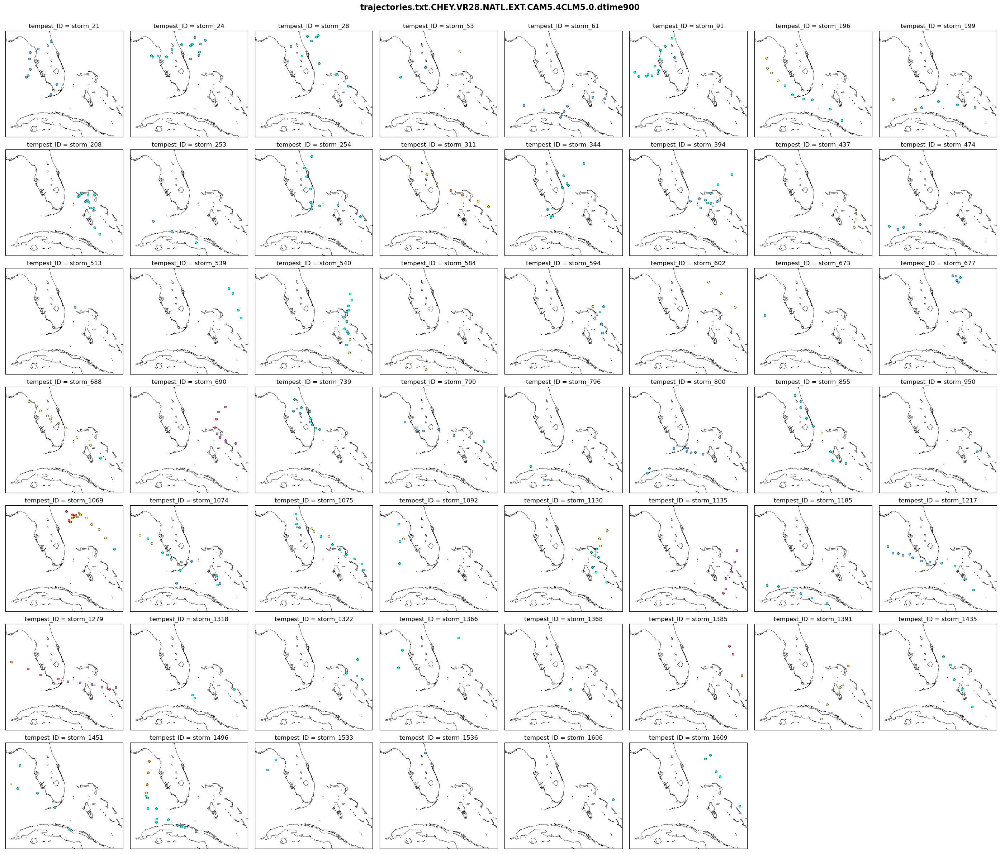

In [55]:
[compare_te_tracks(te_tracks[i], file) for i, file in enumerate(te_track_files)]

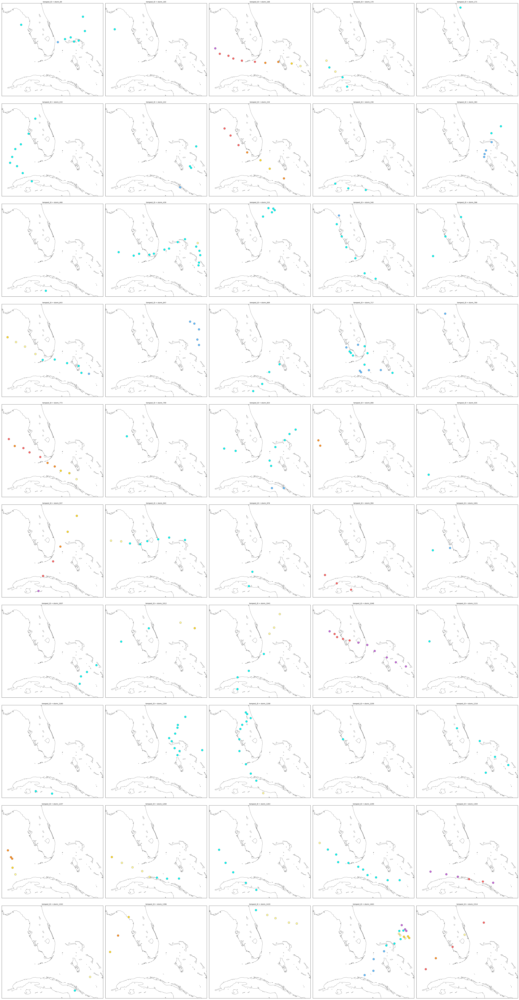

In [18]:
compare_te_tracks(te_tracks[2])

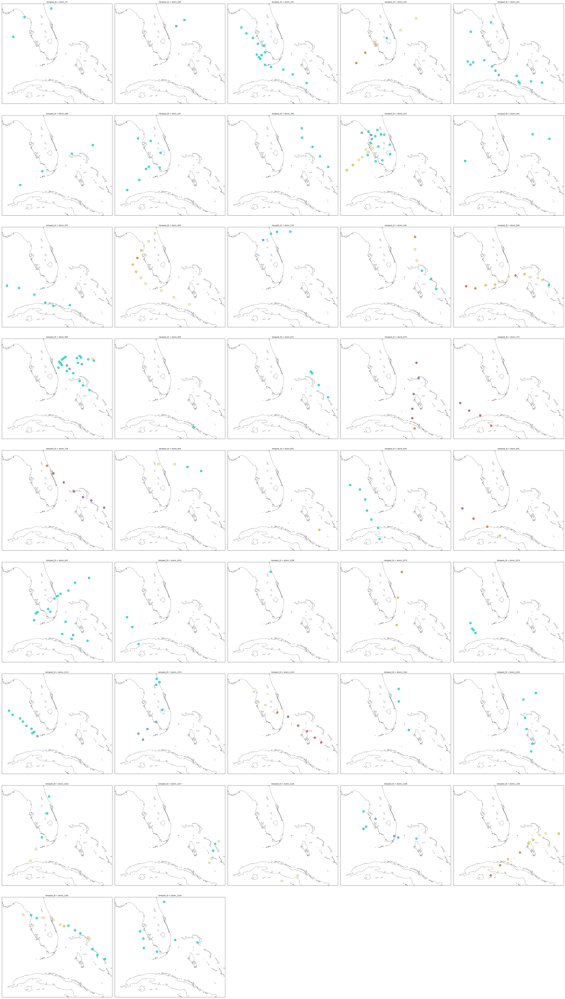

In [19]:
compare_te_tracks(te_tracks[3])

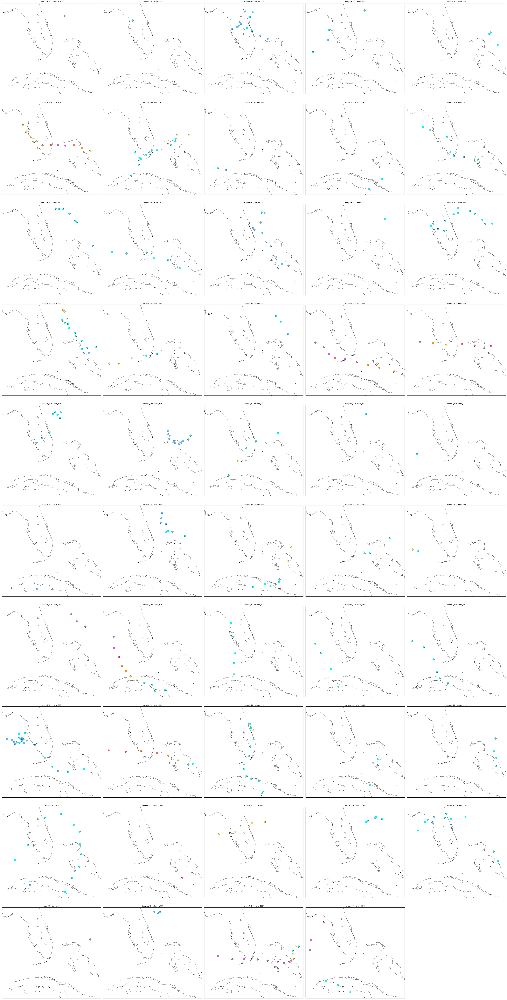

In [20]:
compare_te_tracks(te_tracks[4])

In [16]:
compare_te_tracks(te_tracks[5])

In [21]:
compare_te_tracks(te_tracks[6])

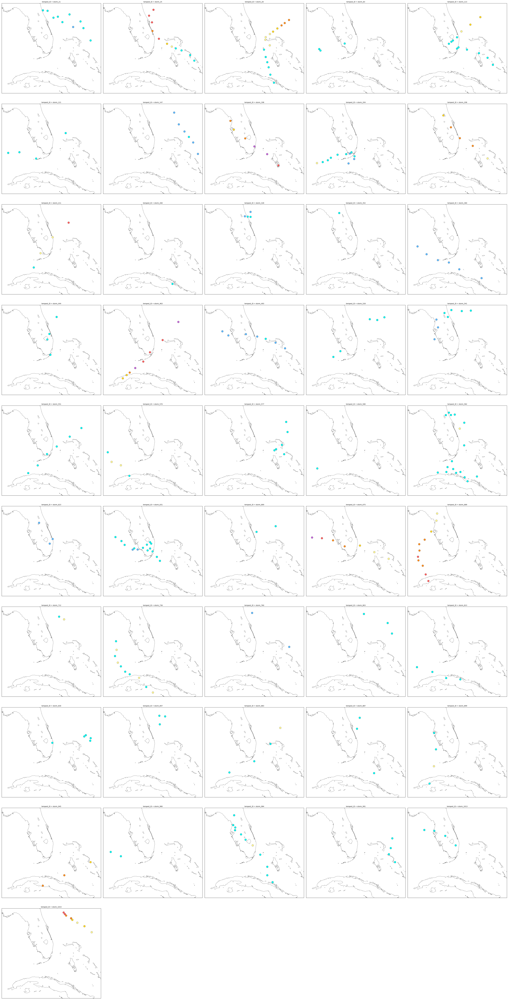

In [22]:
compare_te_tracks(te_tracks[7])

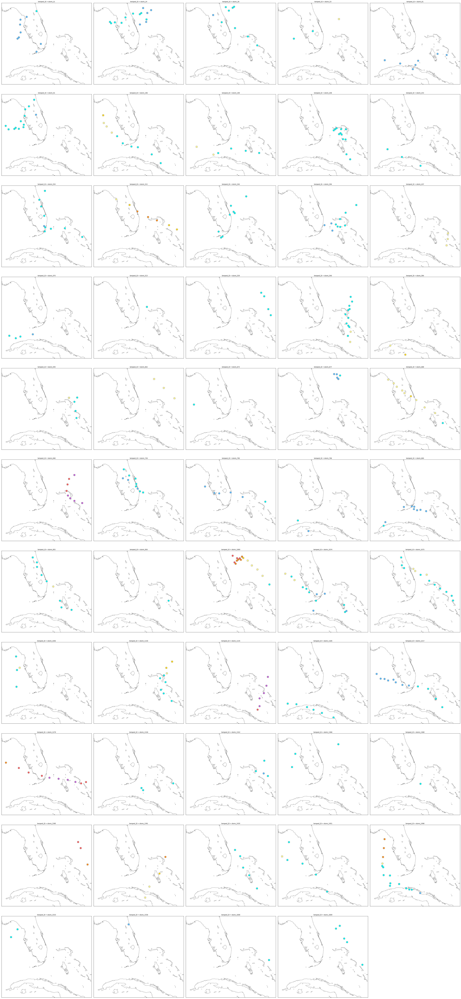

In [23]:
compare_te_tracks(te_tracks[8])

In [124]:
# block to calculate translation speed (needs to be first before dropping due to miami_dist)
test_df = te_track_dfs[0].copy()
test_df['tempest_ID'].unique()
#[test_df[test_df == storm].apply(lambda x: haversine_vector((x.lat, x.lon), (x.lat, *x.lon), unit='mi', 
                                                                 normalize=True)[0], axis=1).round(4) for storm in test_df['tempest_ID'].unique()]

array(['storm_0', 'storm_1', 'storm_2', ..., 'storm_1528', 'storm_1529',
       'storm_1530'], dtype=object)

In [ ]:
# block to calculate translation speed (needs to be first before dropping due to miami_dist)
test_df['t_speed'] = test_df.rolling(2, on='tempest_ID', closed='both').apply(lambda x: haversine_vector(x.lat)

In [112]:
test_df.groupby(['tempest_ID'])['lon'].shift(1)

0               NaN
1         83.116714
2         82.070597
3         82.070597
4         80.359140
            ...    
38858    118.239365
38859    119.008239
38860    119.814654
38861    121.385520
38862    123.473148
Name: lon, Length: 38863, dtype: float64

In [87]:
#test_df['ts1'] = test_df.groupby('tempest_ID', as_index=False)
test_df.groupby('tempest_ID').lon

tempest_ID
storm_0       [nan, nan]
storm_1       [nan, nan]
storm_10      [nan, nan]
storm_100     [nan, nan]
storm_1000    [nan, nan]
                 ...    
storm_995     [nan, nan]
storm_996     [nan, nan]
storm_997     [nan, nan]
storm_998     [nan, nan]
storm_999     [nan, nan]
Length: 1531, dtype: object

In [97]:
test_df

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,t_speed
0,1985-01-25 00:00:00,83.116714,7.634498,98708.27,32.26449,0.000,storm_0,NaN
1,1985-01-25 06:00:00,82.070597,7.592107,99701.32,27.35374,0.000,storm_0,NaN
2,1985-01-25 12:00:00,82.070597,7.592107,99822.81,24.49513,0.000,storm_0,NaN
3,1985-01-25 18:00:00,80.359140,7.493154,100234.10,18.41094,1473.759,storm_0,NaN
4,1985-01-26 00:00:00,79.980944,6.945498,100137.90,16.64115,350.854,storm_0,NaN
...,...,...,...,...,...,...,...,...
38858,2014-12-06 00:00:00,119.008239,-22.209494,99071.34,15.27198,4827.211,storm_1530,NaN
38859,2014-12-06 06:00:00,119.814654,-23.600902,99427.77,14.23425,5750.282,storm_1530,NaN
38860,2014-12-06 12:00:00,121.385520,-24.424525,99674.34,11.88024,5445.413,storm_1530,NaN
38861,2014-12-06 18:00:00,123.473148,-25.477910,99659.17,12.88766,5186.333,storm_1530,NaN


In [72]:
test_df['t_speed'] = test_df.apply(lambda x: haversine_vector((x.lat, x.lon), (*x.lat, *x.lon), unit='mi', 
                                                                 normalize=True)[0], axis=1).round(4)
test_df

TypeError: Value after * must be an iterable, not float

In [78]:

test_df['t_speed'] = test_df.groupby('tempest_ID').\
apply(lambda x: haversine_vector([x.lat, x.lon], 
                                 [x.lat.shift().rolling(1), x.lon.shift().rolling(1)], unit='mi')).reset_index(drop=True)

IndexError: When not in combination mode, arrays must be of same size. If mode is required, use comb=True as argument.

In [125]:
test_df = te_track_dfs[0].copy()
# block to calculate distance from miami
miami_coords = (25.775163, -80.208615)
miami_dist = 500.0 #km
test_df['miami_dist'] = test_df.apply(lambda x: haversine_vector((x.lat, x.lon), 
                                                                 miami_coords, unit='km', 
                                                                 normalize=True)[0], axis=1).round(4)
#test_df = test_df[test_df['miami_dist'].apply(lambda x: x <= miami_dist)].reset_index(drop=True)
test_df

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist
0,1985-06-19 12:00:00,277.813118,27.990064,101544.80,13.90945,292.2202,storm_24,314.8695
1,1985-06-20 06:00:00,277.600276,27.381539,101545.40,13.66295,117.8023,storm_24,281.7383
2,1985-06-20 12:00:00,277.542548,28.308044,101422.50,11.70446,227.1171,storm_24,359.0443
3,1985-06-20 18:00:00,276.471536,27.856894,101262.40,14.82899,0.0000,storm_24,402.6086
4,1985-06-21 00:00:00,277.114503,27.955450,100875.60,19.05283,0.0000,storm_24,359.5338
...,...,...,...,...,...,...,...,...
384,2014-11-10 12:00:00,280.822373,24.637302,97600.48,41.58885,0.0000,storm_1525,163.6052
385,2014-11-10 18:00:00,281.473588,24.714577,98524.67,32.90224,0.0000,storm_1525,206.2299
386,2014-11-11 00:00:00,282.061084,25.571008,98525.06,36.66492,0.0000,storm_1525,228.5916
387,2014-11-11 06:00:00,283.144112,26.367210,98478.59,34.71471,0.0000,storm_1525,341.2713


In [126]:
# block to calculate saffir-simpson
test_df['ss_wsp'] = test_df.apply(lambda x: saffir_simpson(x.wsp, 'm/s'), axis=1)
test_df

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist,ss_wsp
0,1985-06-19 12:00:00,277.813118,27.990064,101544.80,13.90945,292.2202,storm_24,314.8695,Tropical Storm
1,1985-06-20 06:00:00,277.600276,27.381539,101545.40,13.66295,117.8023,storm_24,281.7383,Tropical Storm
2,1985-06-20 12:00:00,277.542548,28.308044,101422.50,11.70446,227.1171,storm_24,359.0443,Tropical Storm
3,1985-06-20 18:00:00,276.471536,27.856894,101262.40,14.82899,0.0000,storm_24,402.6086,Tropical Storm
4,1985-06-21 00:00:00,277.114503,27.955450,100875.60,19.05283,0.0000,storm_24,359.5338,Tropical Storm
...,...,...,...,...,...,...,...,...,...
384,2014-11-10 12:00:00,280.822373,24.637302,97600.48,41.58885,0.0000,storm_1525,163.6052,Category 1
385,2014-11-10 18:00:00,281.473588,24.714577,98524.67,32.90224,0.0000,storm_1525,206.2299,Tropical Storm
386,2014-11-11 00:00:00,282.061084,25.571008,98525.06,36.66492,0.0000,storm_1525,228.5916,Category 1
387,2014-11-11 06:00:00,283.144112,26.367210,98478.59,34.71471,0.0000,storm_1525,341.2713,Category 1


In [127]:
# List of storm ID's for cat 5's to check
test_df[test_df['ss_wsp'] == 'Category 5'].tempest_ID.unique()

array(['storm_29', 'storm_236', 'storm_267', 'storm_528', 'storm_1508'],
      dtype=object)

In [128]:
test_df[test_df['ss_wsp'] == 'Category 5']

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist,ss_wsp
11,1985-09-15 12:00:00,284.089607,23.862352,95613.16,73.38383,0.0,storm_29,483.0902,Category 5
47,1989-08-23 00:00:00,283.001847,23.078309,90256.03,87.13704,0.0,storm_236,442.1955,Category 5
48,1989-08-23 06:00:00,282.381006,23.540762,90592.90,80.42468,0.0,storm_236,360.8298,Category 5
49,1989-08-23 12:00:00,281.651814,23.920807,91601.78,76.31871,0.0,storm_236,278.8361,Category 5
50,1989-08-23 18:00:00,280.652663,24.507471,90759.94,73.80475,0.0,storm_236,165.4867,Category 5
51,1989-08-24 00:00:00,280.231895,25.383040,90553.23,74.92215,0.0,storm_236,62.0738,Category 5
71,1990-06-02 18:00:00,275.843736,25.913134,93537.96,72.30181,0.0,storm_267,395.3386,Category 5
127,1995-08-07 06:00:00,283.763141,24.292746,93764.52,82.93830,0.0,storm_528,432.7422,Category 5
128,1995-08-07 12:00:00,282.222186,25.016947,92161.77,83.46978,0.0,storm_528,258.3131,Category 5
129,1995-08-07 18:00:00,280.845604,25.854517,92016.97,77.54966,0.0,storm_528,105.8937,Category 5


In [ ]:
# block to calculate translation speed
